# ENPM673 PROJECT3


**QUESTION 1**
For this assignment, you are required to perform single camera calibration using either a chessboard or circular pattern.
You will need to follow the steps outlined below and provide detailed explanations for each step of the calibration process.
1. Image Collection:
a. Collect approximately 50 images of a calibration board using a camera of your choice.
b. Save these images to your Google Drive. Also, add the link to these images in a text cell of your .ipynb file.
[Note: You might use the similar calibration board, but every individual should take their own 50 Images]
2. Calibration Pipeline:
a. Choose either a chessboard or circular pattern for calibration.
b. Explain the process of corner detection or centroid detection for the chosen pattern.
c. You do not need to write any function from scratch, Utilize OpenCV functions for camera calibration.
d. Provide a step-by-step explanation of each stage of the calibration pipeline and write code for it, including
the initialization of calibration parameters, image undistortion, and optimization of camera intrinsic and
extrinsic parameters.
[Note: Make sure you display the image and the undistorted image results.]
3. Reprojection Error Analysis:
a. Plot a graph showing the reprojection error for each image used in the calibration process.
b. The x-axis should represent the image number, and the y-axis should represent the reprojection error.
c. Discuss the significance of the reprojection error and its implications for the accuracy of the calibration.
4. Visualization of Calibration Results:
a. After calibration, redraw the detected corners or centroids on the original images.
b. Show the detected corners/centroids before and after calibration.
c. Differentiate between the original corner/centroid detection and the reprojection of these points based
on the calculated camera parameters (R, T, and K).
d. Use different colors to represent the original and reprojected points for clarity.

Use this link to access the photos : https://drive.google.com/drive/folders/18klvfbRh91VTryq8olr9c5frVX24102A?usp=drive_link

METHOD: For this problem, I have takem 73 pictures of a chess board with same focus. Let us see what and how the camera calibration is done.

This section is used to add the necessary packages and mount google drive  to extract the necessary files required for the camera calibration

In [ ]:
#import all necessary library
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve
import os
from PIL import Image
from google.colab.patches import cv2_imshow
from datetime import datetime


In [ ]:
#mount google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In this section, we define the folder where the pictures of the chessboard are stored. We thenn retrieve them and cover all the images into BGR for image processing and store in a list "images"


In [ ]:
folder_path = "/media/project3_q1_pics/" #define the folder path

#list the files in the directory
files = os.listdir(folder_path)

#initi a list to hold the images for chessboard
images = []

#loop through the files
for file_name in files:
    if file_name.lower().endswith('.jpg'):  # Check if the file is a .jpg
        file_path = os.path.join(folder_path, file_name)

        #open the image file
        with Image.open(file_path) as img:
            numpy_image = np.array(img)  #convert PIL Image to NumPy array
            numpy_image = cv2.cvtColor(numpy_image, cv2.COLOR_RGB2BGR)  #convert RGB to BGR
            images.append(numpy_image)  #append a copy of the image to the list to store and use for further processing

#the length or number of images to be used for calibration
print(f"Loaded {len(images)} images.")

Loaded 73 images.


These lines below set up the 3D world coordinates for the chessboard corners used in camera calibration. The objp array holds the (x, y, z) coordinates for each corner, with z set to zero to reflect that the chessboard is on a flat surface. The x, y coordinates are generated to match the grid layout of an 8x6 chessboard, assuming the corners include all intersection points visible in the calibration images.*italicized text*

In [ ]:
#initialize a array to hold the 3D coordinates for cornors of chessboard
objp = np.zeros((6*8, 3), np.float32)
#set the x, y coordinates for each corner
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)


Initialize the list to store the 2D and 3D points and the criteria defines the termination criteria for the corner sub-pixel accuracy refinement process, using both the count of iterations and the required accuracy level. This ensures that the corner detection algorithm terminates either when it has sufficiently refined the corner locations or after a maximum of 30 iterations.

In [ ]:
objpoints = [] #list to store the 3d points in real world space
imgpoints = [] #list to store the 2d points in image plane.
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)#define the termination criteria


The code section below converts each imageto grayscale for effective corner detection. The cv2.findChessboardCorners function detects an 8x6 grid of corners in the image. If corners are successfully detected,it refines the cornors and they are stored in objpoints and imgpoints respectively, which are later used to compute the camera's calibration parameters

In [ ]:
# images = glob.glob('path_to_images/*.jpg')
for fname in images:
    # img = cv2.imread(fname)
    gray = cv2.cvtColor(fname, cv2.COLOR_BGR2GRAY)#convert to grayscale
    ret, corners = cv2.findChessboardCorners(gray, (8,6), None) #find cornors in the chessboard
    if ret == True: #Check if corners were found
        objpoints.append(objp)
        corners2 = cv2.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)#refine the cornor position
        imgpoints.append(corners2)#save in the list


This code block checks if the calibration was successfull and it performs the calibration to determine the camera's parameters necessary for precise imaging tasks


In [ ]:
#proceed with calibration if enough images are successfully processed
if len(objpoints) > 0 and len(imgpoints) > 0:
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)#calibrate and find camera's intrinsic parameters and distortion coefficients
    print("RMS re-projection error:", ret)
    print("Camera matrix:\n", mtx)
    print("Distortion coefficients:\n", dist)
    print("Rotation vectors:\n", rvecs)
    print("Translation vectors:\n", tvecs)

    print("Camera calibration successful.")
else:
    print("Not enough images were processed successfully for calibration.")#if calibration is not successful throw an errror

RMS re-projection error: 1.0165538563312133
Camera matrix:
 [[1.69067291e+03 0.00000000e+00 8.24054362e+02]
 [0.00000000e+00 1.68952545e+03 3.51740596e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Distortion coefficients:
 [[ 0.37726728 -1.92695079 -0.01242372 -0.00782293  3.8747802 ]]
Rotation vectors:
 (array([[ 0.16679704],
       [ 0.05930722],
       [-0.19618412]]), array([[ 0.08786876],
       [ 0.09951223],
       [-0.0046141 ]]), array([[-0.06164912],
       [ 0.11913373],
       [-1.553335  ]]), array([[ 0.07344902],
       [ 0.06359327],
       [-0.00270192]]), array([[-0.06893842],
       [ 0.04236412],
       [-0.01475962]]), array([[-0.04696225],
       [-0.03263378],
       [-0.2692739 ]]), array([[-0.11633841],
       [ 0.10715916],
       [ 0.03124414]]), array([[-0.16690491],
       [ 0.00710088],
       [-1.06733836]]), array([[-0.02083422],
       [ 0.07246627],
       [-0.01631977]]), array([[-0.04151215],
       [ 0.01879133],
       [ 0.29655516]]), array

The code calculates the mean reprojection error which tells how accurately the camera parameters allow for projecting 3D points back to 2D space across all calibration images. It projects each set of 3D object points into the 2D image plane using the calibrated camera parameters and calculates reprojection error for each image, and averages these errors.

In [ ]:
total_error = 0  #initialize total reprojection error as zero

#iterate over all sets of object points
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)#project the 3D object points onto 2D image plane using the calibrated parameters
    error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2) / len(imgpoints2)#calculate the reprojection error between original and projected points
    total_error += error
#calculate the mean of the reprojection errors
mean_error = total_error / len(objpoints)
#print the mean reprojection error
print(f"Mean reprojection error: {mean_error}")


Mean reprojection error: 0.12852596252426052


This code section does undistortion using camera calibration data. It uses the camera matrix and distortion coefficients to correct each image, and the corrected images are stored for further use or display. The process involves calculating an optimal new camera matrix that maximizes the usable area of the undistorted image. Below the code, each image is displayed alongside its undistorted version

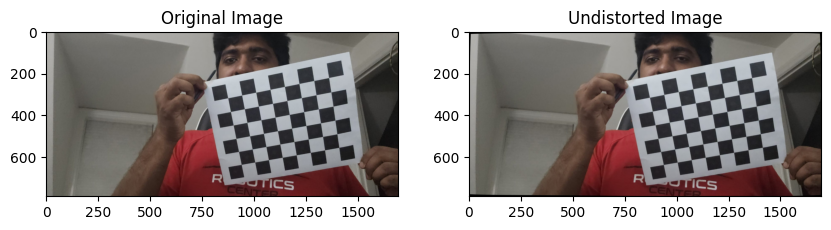

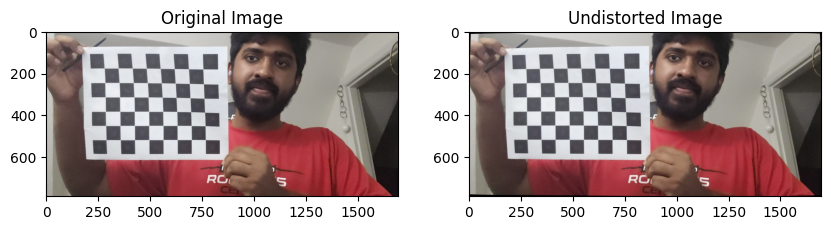

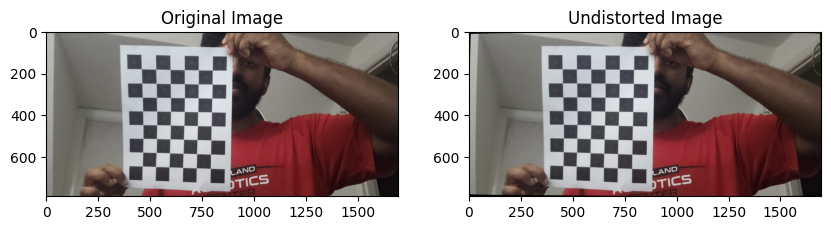

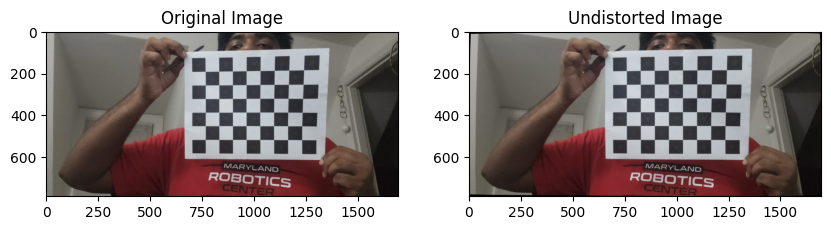

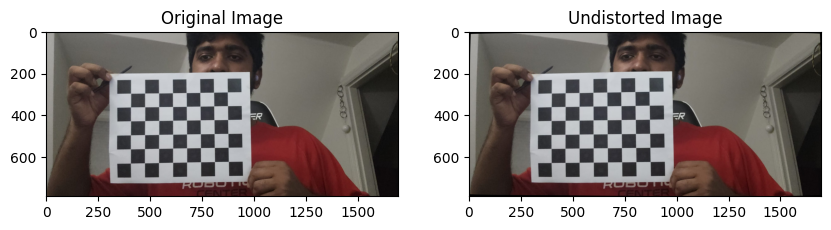

...

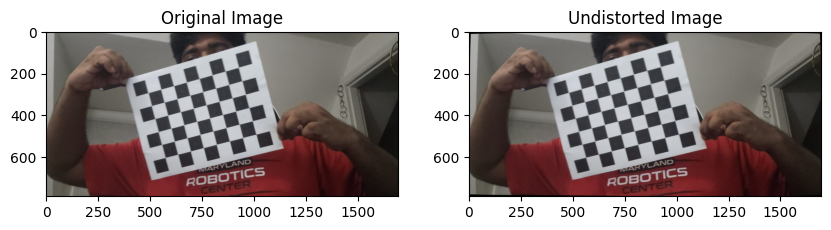

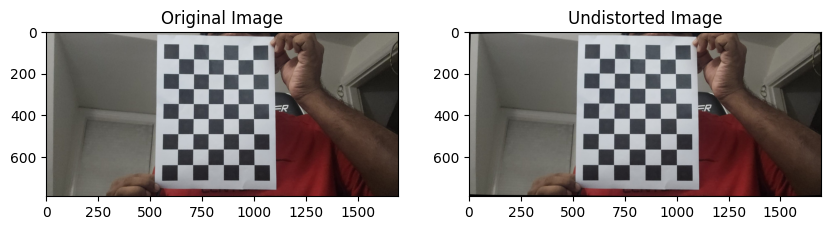

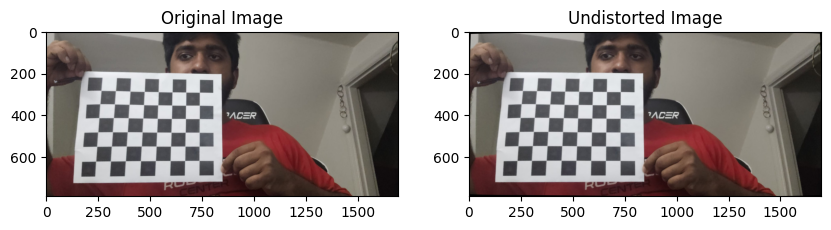

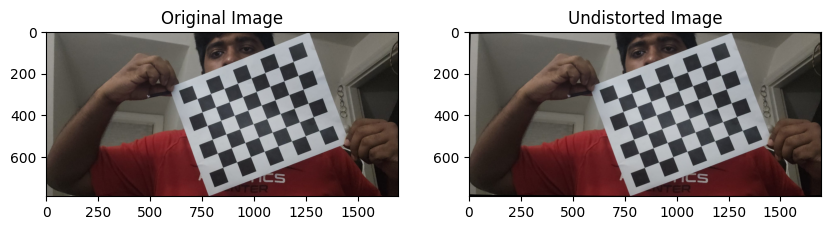

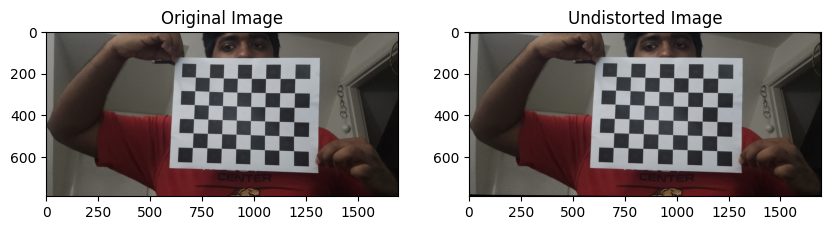

New camera matrix: [[1.74311796e+03 0.00000000e+00 8.16438084e+02]
 [0.00000000e+00 1.71181547e+03 3.49360037e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


In [ ]:
undis_images = [] #list to store undistorted images
for fname in images: #loop through all the images


  h, w = fname.shape[:2]#extract the shape or image dimension
  newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))#Get the optimal new camera matrix
  undistorted_img = cv2.undistort(fname, mtx, dist, None, newcameramtx)#undistort the image using the original camera matrix and the new optimal matrix
  undis_images.append(undistorted_img)#append the undistorted images
  #plot and show the original and undistorted images
  plt.figure(figsize=(10, 4))
  plt.subplot(121)
  plt.imshow(cv2.cvtColor(fname, cv2.COLOR_BGR2RGB))
  plt.title('Original Image')
  plt.subplot(122)
  plt.imshow(cv2.cvtColor(undistorted_img, cv2.COLOR_BGR2RGB))
  plt.title('Undistorted Image')
  plt.show()
print("New camera matrix:", newcameramtx)

This code section calculates the reprojection error and displays this in a graph as asked in the problem statement

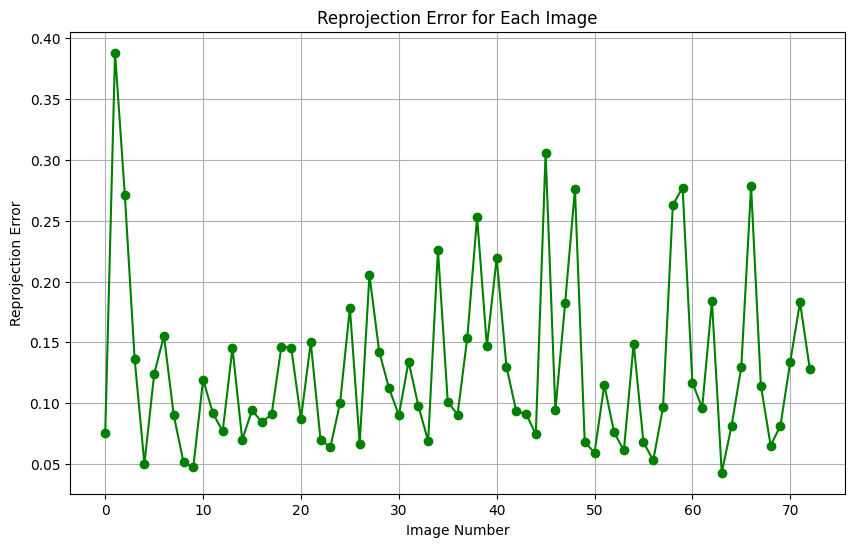

In [ ]:
errors = []#list to store error to plot
reproj_points = []#list to store teh reprojection points
# Calculate reprojection errors
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)#project the points
    error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2) / len(imgpoints2)#calcualte erroor
    errors.append(error)#store the error
    reproj_points.append(imgpoints2)#store the reprojection points
#plotting the reprojection errors in a graph
plt.figure(figsize=(10, 6))
plt.plot(errors, marker='o', linestyle='-', color='g')
plt.title('Reprojection Error for Each Image')
plt.xlabel('Image Number')
plt.ylabel('Reprojection Error')
plt.grid(True)
plt.show()

Significance of Reprojection error:

Reprojection error is crucial for evaluating the accuracy of camera calibration, as it quantifies the difference between points detected in images and points projected through camera parameters. A lower reprojection error signifies a higher accuracy of the calibration, indicating that the camera's estimated parameters closely align with its actual characteristics.It sarves as a standard for assessing the quality of the calibration but also helps in identifying potential issues within the calibration process, such as inaccurate detection. In contexts requiring high precision, such as 3D modeling, augmented reality, and robotics, maintaining minimal reprojection error is vital for ensuring that subsequent applications relying on these parameters achieve robust and reliable results.

The two sections below, finds the coroner of the undistored image and plots them on the origiinal image for visualization

In [ ]:
undis_imgpoints = []#create a empty list to store undistorted points
for fname in undis_images:
    gray = cv2.cvtColor(fname, cv2.COLOR_BGR2GRAY)#convert to grayscale to process it
    ret, corners = cv2.findChessboardCorners(gray, (8,6), None)#find corners
    if ret == True:
        corners2 = cv2.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)#refine the corners
        undis_imgpoints.append(corners2)


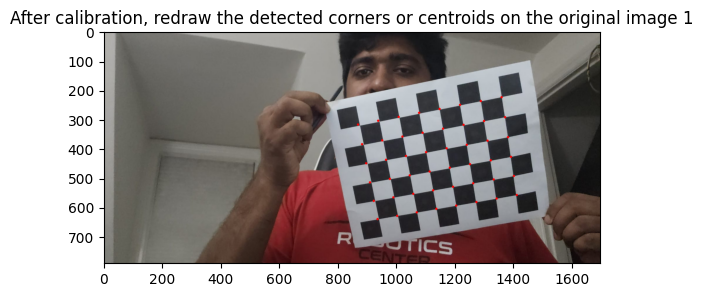

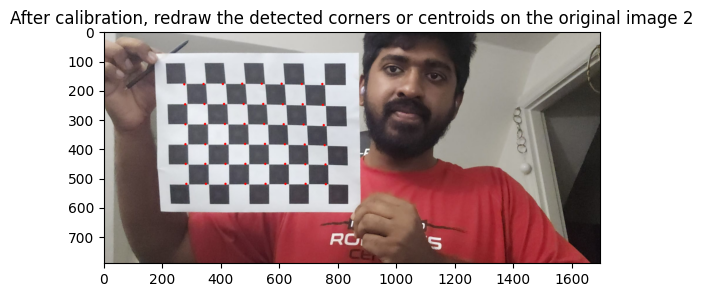

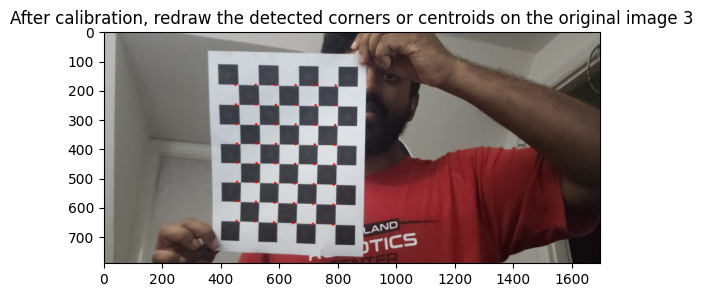

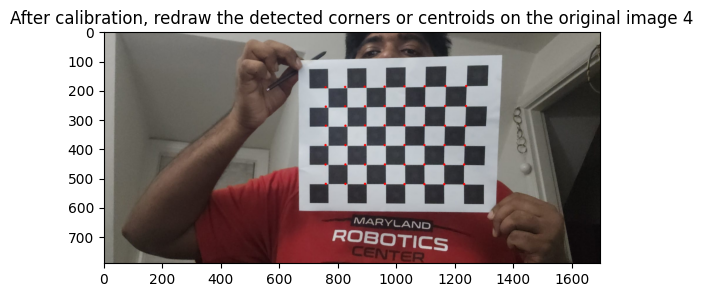

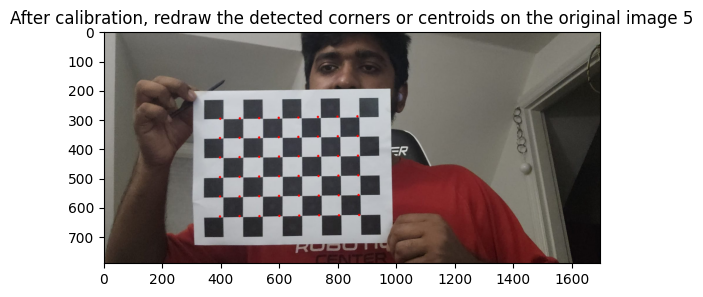

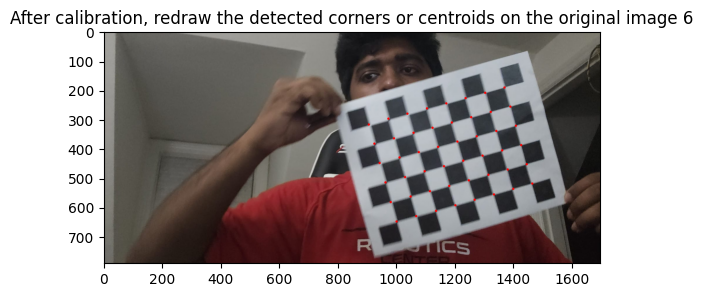

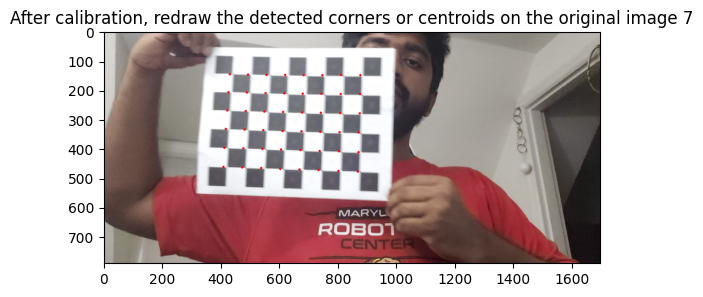

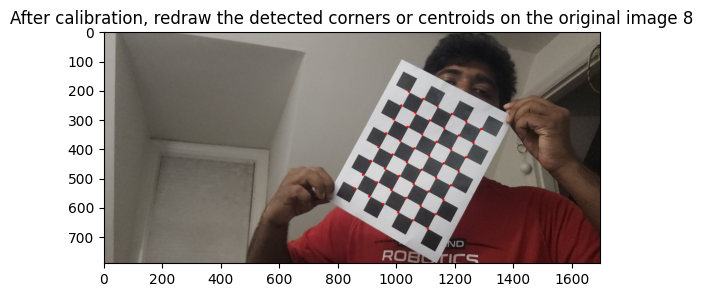

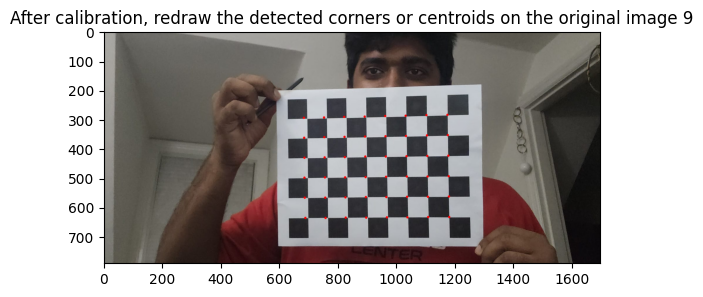

In [ ]:
i = 0#create an empty variable to keep the count
for org in images:
    undis_cornor_img = org.copy()#copy the undistorted image
    #iterate through the coners and draw circle
    for corner in undis_imgpoints[i]:
        cv2.circle(undis_cornor_img, tuple(corner.ravel().astype(int)), 4, (0, 0, 255), -1)  # Blue color
    i = i+1
    if i ==10:
      break
    #plot the corner in original image
    plt.imshow(cv2.cvtColor(undis_cornor_img, cv2.COLOR_BGR2RGB))
    plt.title(f'After calibration, redraw the detected corners or centroids on the original image {i}')
    plt.show()


This section below is used to compare the corner detection before and after image undistortion








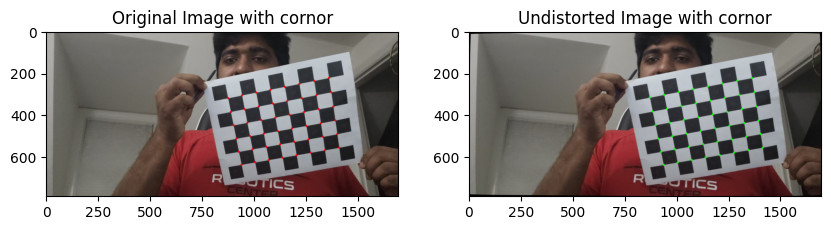

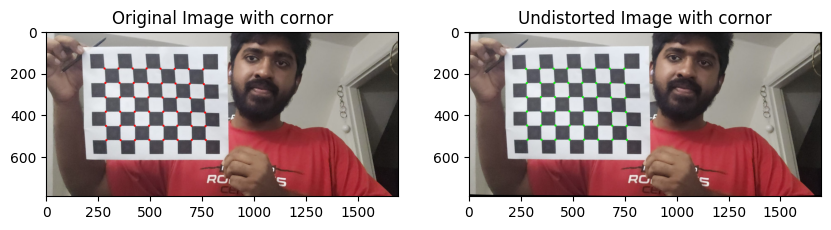

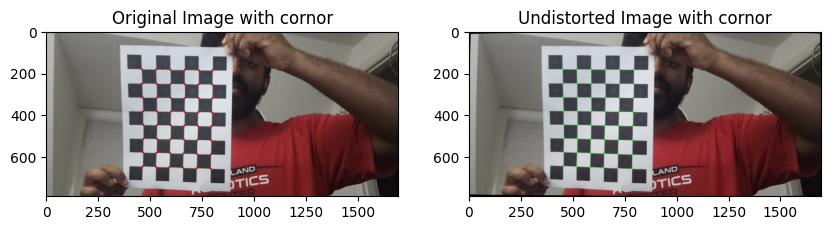

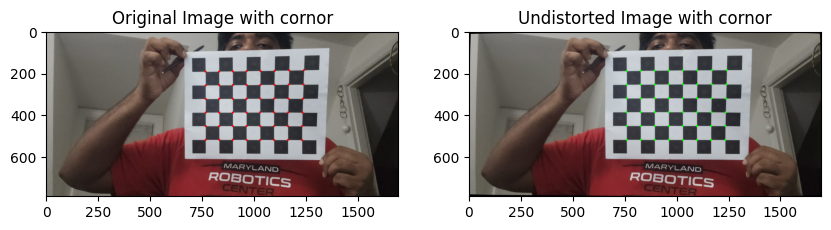

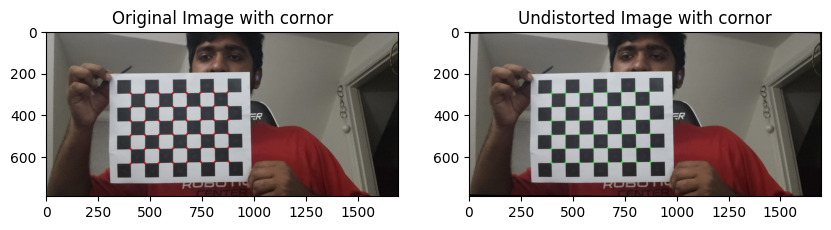

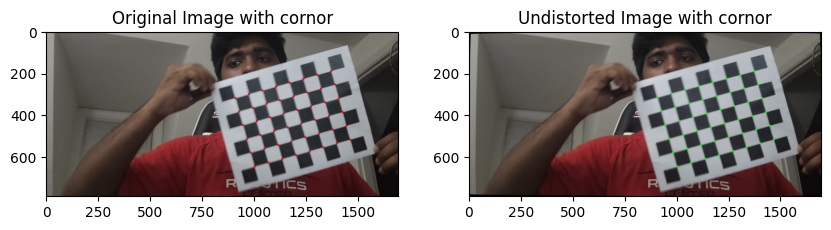

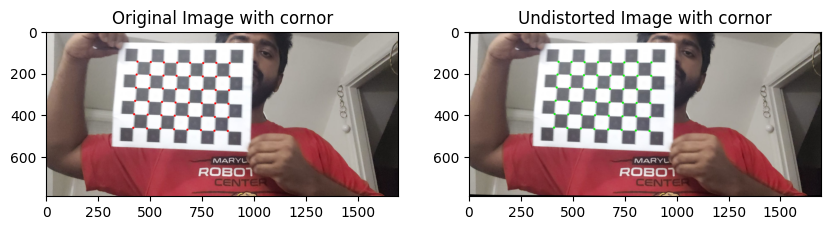

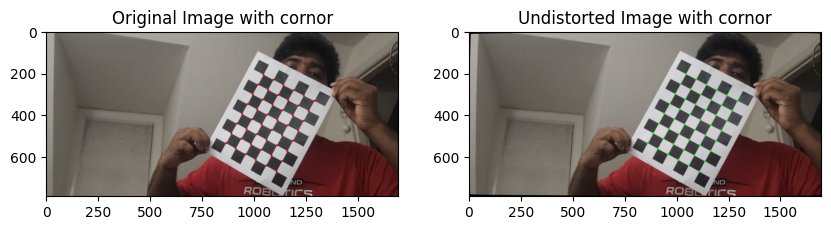

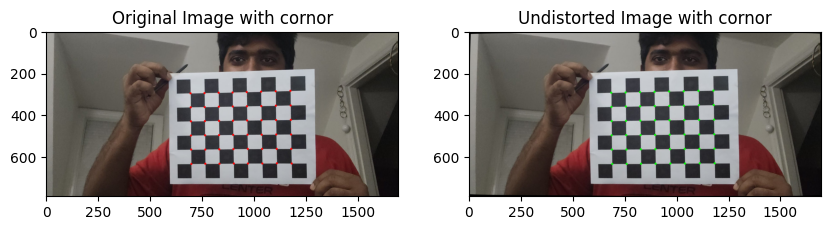

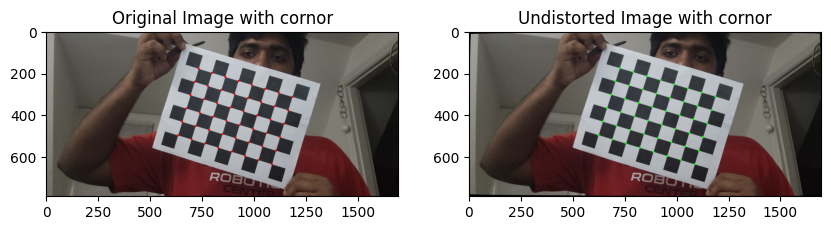

In [ ]:
i=0#create a dummy cornor
for org in images:#go through the images
      org_imgs = images[i].copy()#crreate a copy of the original image
      undis_imgs = undis_images[i].copy()#create a copy of undistorted image
      #draw the cornors using circles for both the images
      for corner in imgpoints[i]:
        cv2.circle(org_imgs, tuple(corner.ravel().astype(int)), 5, (0, 0, 255), -1)  # Blue color
      for corner in undis_imgpoints[i]:
        cv2.circle(undis_imgs, tuple(corner.ravel().astype(int)), 5, (0, 255, 0), -1)  # Blue color
      #plot and visualize the images and respective cornors
      plt.figure(figsize=(10, 4))
      plt.subplot(121)
      plt.imshow(cv2.cvtColor(org_imgs, cv2.COLOR_BGR2RGB))
      plt.title('Original Image with cornor')
      plt.subplot(122)
      plt.imshow(cv2.cvtColor(undis_imgs, cv2.COLOR_BGR2RGB))
      plt.title('Undistorted Image with cornor')
      plt.show()
      i=i+1
      if i ==10:
        break

This script below  compares the original detected corners against the reprojected corners on undistorted images

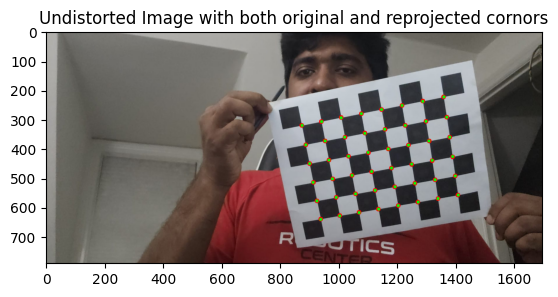

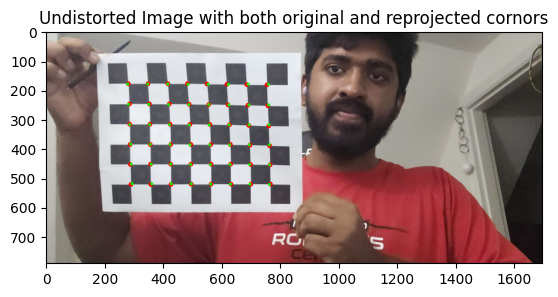

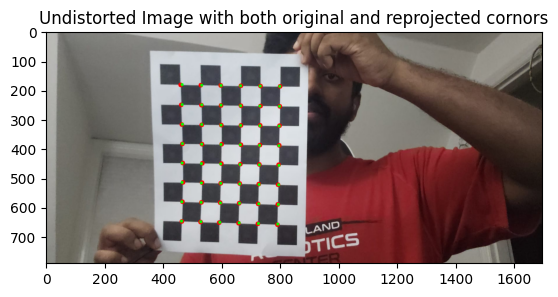

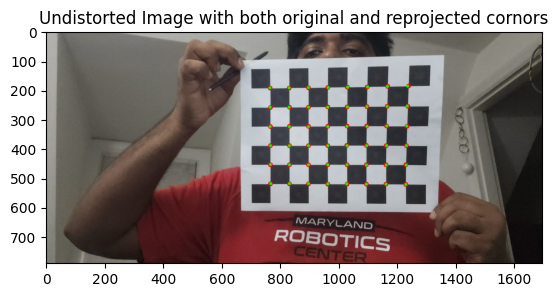

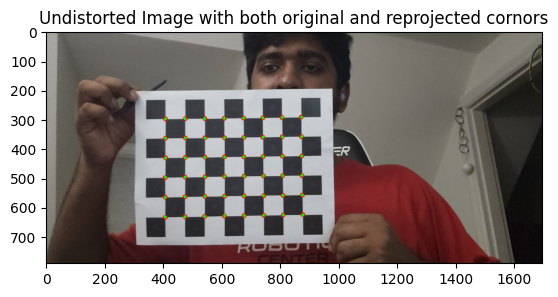

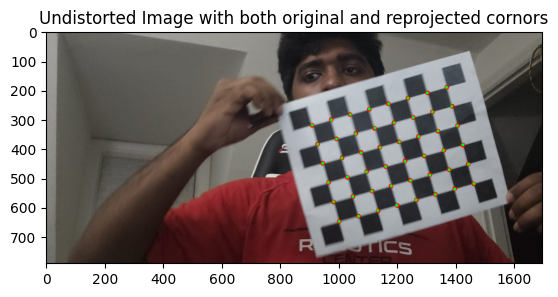

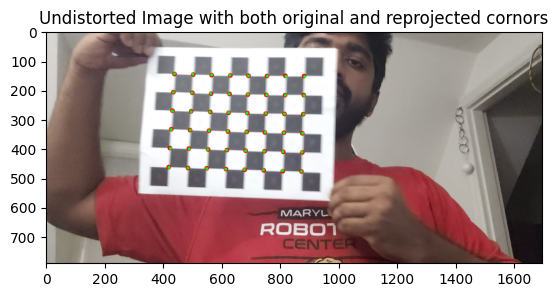

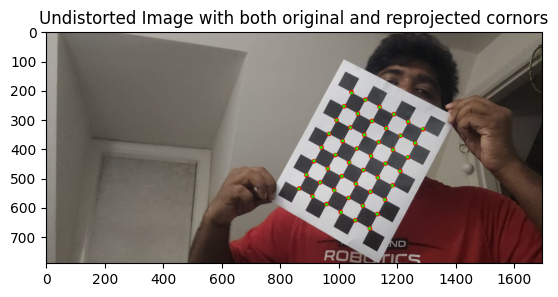

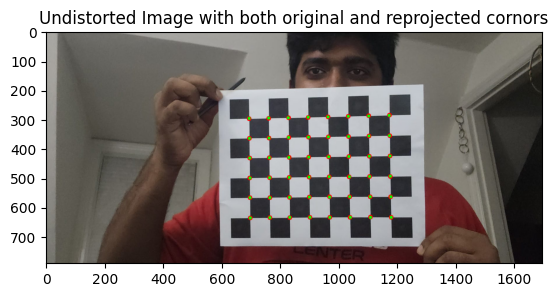

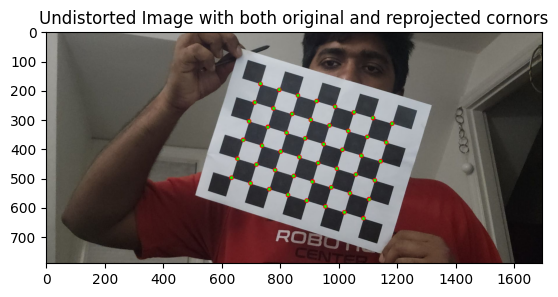

In [ ]:
i=0
for ing in range(len(images)):#iterate through all the images
    image = images[i].copy()#make a copy of the original image
    undistorted_image = cv2.undistort(image, newcameramtx, dist, None)  #undistort the image using the camera matrix
    proj_pts, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)#project the points using the camera parameters

    plot_im = image.copy()
    original_corners = imgpoints[i].reshape(-1, 1, 2)#reshape the storesd points of original image cornors

    #draw original corners and the reprojected conrors on the undistorted image
    for corner in original_corners:
        cv2.circle(plot_im, tuple(corner.ravel().astype(int)), 8, (0, 0, 255), -1)  #red color
    for corner in proj_pts.reshape(-1, 2):
        cv2.circle(plot_im, tuple(corner.ravel().astype(int)), 5, (0, 255, 0), -1)  #green color
    i=i+1
    #display the comparison image
    plt.imshow(cv2.cvtColor(plot_im, cv2.COLOR_BGR2RGB))
    plt.title('Undistorted Image with both original and reprojected cornors')
    plt.show()
    if i ==10:
      break

**QUESTION 2**

Link to the images: https://drive.google.com/drive/folders/1wkjEqhttgPs0nDvFVnsBeinE7ukYL2-f?usp=sharing
You are provided with three datasets [1], each containing two images of the same scene captured from different camera
perspectives. Each dataset includes a calib.txt file detailing camera matrices, baseline, image size, and other parameters
necessary for calibration and stereo vision.
Pipeline for Creating a Stereo Vision System:
1. Calibration:
a. Identify matching features between the two images in each dataset using any feature matching algorithms.
b. Estimate the Fundamental matrix using RANSAC method based on the matched features.
c. Compute the Essential matrix from the Fundamental matrix considering calibration parameters.
d. Decompose the Essential matrix into rotation and translation matrices.
2. Rectification:
a. Apply perspective transformation to rectify images and ensure horizontal epipolar lines.
b. Print the homography matrices (H1 and H2) for rectification.
c. Visualize epipolar lines and feature points on both rectified images.
3. Compute Depth Image:
a. Calculate the disparity map representing the pixel-wise differences between the two images.
b. Rescale the disparity map and save it as grayscale and color images using heat map conversion.
c. Utilize the disparity information to compute depth values for each pixel.
d. Generate a depth image representing the spatial dimensions of the scene.
e. Save the depth image as grayscale and color using heat map conversion for visualization.

For this problem, I have solved it using funtion for seperate set of actions and at the last, I have called the folders needed to process. Lets see the process:

This section of code is used to extract camera calibration data for the specified folder and its associated images . It reads calibration parameters from a text file, converting these values into structured formats suitable for processing—such as matrices for camera parameters and numeric values for other calibration-related settings.It also the code loads two images intended for stereo vision analysis.

In [ ]:
#import libraries
import cv2
import numpy as np
#define folder path
file_path = "/media"
def read(fold_name):#main function which starts the entire logic
  #this function is used to reader from the folder specified and extract the calibration data
  def parse_calibration_file(file_pa):
      img1 , img2 = image_files(file_pa)#calls the image_files funtion to read the images from the folder
      #define a dictionary to hold calibration data
      calibration_data = {}
      fil = file_path+file_pa+"/calib.txt"
      #open and read the calibration file
      with open(fil, 'r') as file:
          for line in file:
              #split the line into key-value pairs
              key, value = line.split('=')
              #remove any whitespace and newline characters
              key = key.strip()
              value = value.strip()

              # Process the values as needed and add to the dictionary
              if key in ['cam0', 'cam1']:
                  # Convert the string to a numpy array
                  mat = np.array([[float(num) for num in row.split()] for row in value[1:-1].split(';')])
                  calibration_data[key] = mat
              else:
                  # Convert single values to their appropriate data types
                  calibration_data[key] = int(value) if value.isdigit() else float(value)
      print(calibration_data)
      return calibration_data, img1, img2
  #function to extract the pictures in the file
  def image_files(directory):
      img1 = cv2.imread(file_path + directory+"/im0.png")
      img2 = cv2.imread(file_path + directory+"/im1.png")
      return img1 , img2
  #use the function to read the calibration file
  calibration_data, img1, img2 = parse_calibration_file(fold_name)
  data, img11, img22 = matrix_calc(img1, img2, calibration_data,fold_name)#call the next function to get the matrices assked and create a rectified image
  return data, img11, img22

This section of code processess the images by converting images to grayscale, detecting features using the SIFT algorithm, and matching these features across two images. The matches are then filtered to retain only the most reliable ones. Using these filtered matches, the script calculates the fundamental and essential matrices as asked and prints them.

It then decomposes the essential matrix to extract the relative rotation and translation between the camera viewpoints. It visualizes the matched features and performs stereo rectification to align the images for easier disparity calculation. Finally, the images are rectified, and epipolar geometry is used to process it.

In [ ]:
#this function calculates the matrix, decomposes into required matrix and also rectifies the image because only rectified images (same dimension) can be used to visualize the epipolar lines
def matrix_calc(img1, img2, calibration_data,fold_name):
  imgL = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)#cvt to grayscale
  imgR = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
  #check if images are loaded correctly
  if imgL is None or imgR is None:
      raise ValueError("Images have not been loaded correctly.")
  #detecting features using SIFT algorithm
  sift = cv2.SIFT_create()
  #find the keypoints and descriptors with SIFT in both images
  keypoints_1, descriptors_1 = sift.detectAndCompute(imgL, None)
  keypoints_2, descriptors_2 = sift.detectAndCompute(imgR, None)
  #create FLANN matcher
  FLANN_INDEX_KDTREE = 1
  index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
  search_params = dict(checks=50)
  #initialize the flann based marcher
  flann = cv2.FlannBasedMatcher(index_params, search_params)
  #match descriptors using flann
  matches = flann.knnMatch(descriptors_1, descriptors_2, k=2)
  #apply ratio test to find good matches (i have take 0.7)
  good_matches = []#list to store good matched
  for i, (m, n) in enumerate(matches):
      if m.distance < 0.7* n.distance:
          good_matches.append(m)#append the valies which pass the req ratio
  #extract the point coordinates from the good matches
  pts1 = np.int32([keypoints_1[m.queryIdx].pt for m in good_matches])
  pts2 = np.int32([keypoints_2[m.trainIdx].pt for m in good_matches])
  #calculate the fundamental matrix using RANSAC
  F, mask = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC)
  #make sure that the mask is the same size as the point arrays
  assert pts1.shape[0] == mask.shape[0], f"pts1 length: {pts1.shape[0]}, mask length: {mask.shape[0]}"
  assert pts2.shape[0] == mask.shape[0], f"pts2 length: {pts2.shape[0]}, mask length: {mask.shape[0]}"
  #apply the mask to filter inliers
  pts1_inliers = pts1[mask.ravel() == 1]
  pts2_inliers = pts2[mask.ravel() == 1]
  #find the essential matrix using the camera parameters and the fundamental matrix
  K1 = calibration_data['cam0']  #extract from the dic crated in prev section
  K2 = calibration_data['cam1']
  #extracting the points
  pts1 = pts1[mask.ravel()==1]
  pts2 = pts2[mask.ravel()==1]
  step = 10
  pts1 = pts1[::step,:]
  pts2 = pts2[::step,:]

  #computing the essential matrix
  E, _ = cv2.findEssentialMat(pts1, pts2, K1, method=cv2.RANSAC, prob=0.999, threshold=1.0)
  #decompose the essential matrix into rotation (R) and translation (t)
  _, R, t, mask = cv2.recoverPose(E, pts1, pts2, K1)
  #print the results
  print("Fundamental Matrix (F): \n", F)
  print("Essential Matrix (E): \n", E)
  print("Rotation Matrix (R): \n", R)
  print("Translation Vector (t): \n", t)
  #create the feature matches
  img_matches = cv2.drawMatches(img1, keypoints_1, img2, keypoints_2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  #plot to visulaize the feature match
  plt.figure(figsize=(12, 6))
  plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
  plt.title('Mached features for the given images')
  plt.axis('off')
  plt.show()
  #assuming no lens distortion
  dist_coeffs = np.zeros((5,1))
  #stereo rectification
  R1, R2, P1, P2, Q, roi1, roi2 = cv2.stereoRectify(
      K1, dist_coeffs,
      K2, dist_coeffs,
      img1.shape[1::-1], R, t, flags=cv2.CALIB_ZERO_DISPARITY, alpha=-1
  )
  #get the width and height from the data
  width = calibration_data['width']
  height = calibration_data['height']
  #rectify maps
  map1_x, map1_y = cv2.initUndistortRectifyMap(K1, dist_coeffs, R1, P1, (width,height), cv2.CV_32FC1)
  map2_x, map2_y = cv2.initUndistortRectifyMap(K2, dist_coeffs, R2, P2, (width,height), cv2.CV_32FC1)
  #rectify images uising the rectified maps
  rectified1 = cv2.remap(img1, map1_x, map1_y, cv2.INTER_LINEAR)
  rectified2 = cv2.remap(img2, map2_x, map2_y, cv2.INTER_LINEAR)
  #crearte sub plot and visualize he recified images
  fig, axes = plt.subplots(1, 2, figsize=(20, 10))
  axes[0].imshow(cv2.cvtColor(rectified1, cv2.COLOR_BGR2RGB), cmap='gray')
  axes[0].set_title('rectified Image 0')
  axes[0].axis('off')
  axes[1].imshow(cv2.cvtColor(rectified2, cv2.COLOR_BGR2RGB), cmap='gray')
  axes[1].set_title('rectified Image 1')
  axes[1].axis('off')
  plt.show()
  #call the next function to find the eppilines or epipolar lines
  data, img11, img22 = epipolar(K1,K2,R1,R2,pts1,pts2,rectified1,rectified2,fold_name)
  return data, img11, img22

The drawlines function visualizes the epipolar lines on a pair of images from different camera perspective. After calculating these lines based on the stereo images' corresponding points, the function draws them across the width of the first image. It also highlights these corresponding feature points on both images with colored circles

In [ ]:
#this function is used to draw the lines and feature points for the lines
def drawlines(img1, img2, lines, pts1src, pts2src):
    r, c,_ = img1.shape#gewt the shape
    img1color = img1
    img2color = img2
    #convert to int32
    pts1 = np.int32(pts1src)
    pts2 = np.int32(pts2src)
    #iterate through the lines and points and plot them
    for r, pt1, pt2 in zip(lines, pts1, pts2):
        color = tuple(np.random.randint(0, 255, 3).tolist())
        x0, y0 = map(int, [0, -r[2] / r[1] ])
        x1, y1 = map(int, [c, -(r[2] + r[0] * c) / r[1] ])
        img1 = cv2.line(img1color, (x0, y0), (x1, y1), color, 1)#draw lines
        img1 = cv2.circle(img1, tuple(pt1), 5, color, -1)#draw the feature points
        img2 = cv2.circle(img2color, tuple(pt2), 5, color, -1)
    return img1color, _#return the image


The function epipolar calculates the homography matrices for two rectified images based on their intrinsic camera matrices K1,K2 and rectification rotations R1,R2. These matrices transform points in the unrectified images into the rectified image plane ensures that corresponding points in both images lie on the same horizontal line, simplifying disparity calculation.

After calculating the homography matrices, the function uses these matrices to draw epipolar lines on the rectified images. This is done by computing corresponding epilines for matched feature points in each image, drawing these lines on the opposite image.Finally, the function displays these images with epilines

In [ ]:
#this funtion creates epipolar lines from the rectrified the image
def epipolar(K1,K2,R1,R2,pts1,pts2,rectified1,rectified2,fold_name):
  #calaculate the Homography Matrix
  H1 = np.linalg.inv(K1) @ R1 @ K1#calculate the homograpy matrix 1
  H2 = np.linalg.inv(K2) @ R2 @ K2#calculate the homograpy matrix 2

  print("Homography Matrix for Image 1 (R1):\n", H1)
  print("Homography Matrix for Image 2 (R2):\n", H2)
  plt.show()
  #find epipolar lines
  lines1 = cv2.computeCorrespondEpilines(pts1.reshape(-1, 1, 2), 2, F)
  lines1 = lines1.reshape(-1, 3)
  lines2 = cv2.computeCorrespondEpilines(pts2.reshape(-1, 1, 2), 2, F)
  lines2 = lines2.reshape(-1, 3)
  rec_epip1,rec_epip2 = rectified1.copy(), rectified2.copy()
  #draw the epipoolse lines using draw lines function given above
  epilines_rectified1, _ = drawlines(rec_epip1, rec_epip2, lines1, pts1, pts2)
  epilines_rectified2, _ = drawlines(rec_epip2, rec_epip1, lines2, pts2, pts1)

  #display the images with epilines
  plt.figure(figsize=(15, 10))
  plt.subplot(121), plt.imshow(epilines_rectified1)
  plt.title('Image 1 with Epilines'), plt.xticks([]), plt.yticks([])
  plt.subplot(122), plt.imshow(epilines_rectified2)
  plt.title('Image 2 with Epilines'), plt.xticks([]), plt.yticks([])
  plt.show()
  #call the next funtion to find and plot the disparity
  disparity(calibration_data , rectified1, rectified2,fold_name)
  return calibration_data , rectified1, rectified2

The function disparity in the below section is used to calculate and visualize the disparity map between two rectified stereo images. This disparity map gives depth information from a stereo pair of images. The function uses the cv2.StereoSGBM_create method to create a stereo block matching object, which computes the disparity map.

The function proceeds to compute the disparity map, which measures the pixel difference or shift between corresponding points in the stereo pair of images. It is normalized to enhance visualization and then converted to a heatmap. This heatmap uses color gradients to represent distance, making the disparity variations between near and far objects in the scene more discernible and the function also adjusts its approach by initializing another StereoSGBM_create instance with specific parameters.

In [ ]:
#define the disparity function with the rectified and caibration data
def disparity(calibration_data, rectified1, rectified2,fold_name):
  ndisp = calibration_data['ndisp']#extrace ndisp from the data
  #############################################################################################
  #create StereoBM or StereoSGBM object
  stereo = cv2.StereoSGBM_create(minDisparity=0,
                                numDisparities=16*5,  # must be divisible by 16
                                blockSize=15)

  #compute the disparity map
  disparity = stereo.compute(rectified1, rectified2).astype(np.float32) / 16.0
  #normalize the disparity map for display
  disp_display = cv2.normalize(disparity, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
  #apply a heat map for better visualization
  disp_color = cv2.applyColorMap(disp_display, cv2.COLORMAP_JET)
  stereo = cv2.StereoSGBM_create(minDisparity=20,numDisparities=int(ndisp),blockSize=5,P1=7*1*4**2,P2=25*2*6**2,disp12MaxDiff=1,uniquenessRatio=13,speckleWindowSize=0,speckleRange=2,preFilterCap=52,mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY)
  disparity = stereo.compute(rectified1, rectified2)#disparity to plot heat map
#############################################################################################

  #plot the dsiaparity in gray and heat side by side
  plt.figure(figsize=(12, 6))
  plt.subplot(121)
  plt.imshow(disp_display, cmap='gray')
  plt.title('Disparity Map in gray')
  plt.axis('off')
  plt.colorbar()
  plt.subplot(122)
  plt.imshow(disparity, cmap='hot')
  plt.title('disparity heat map')
  plt.axis('off')
  plt.colorbar()
  timestamp = datetime.now().strftime("%Y%m%d-%H%M%S")
  filename = f"disparity_map_{timestamp}.png"
  plt.savefig(filename, bbox_inches='tight')
  plt.show()

  #call the next funtion to calculate and show the depth image
  depth_img(calibration_data, disparity,fold_name)


This section of code transforms the disparity map into a depth map using stereo camera calibration parameters, such as baseline distance, disparity offsets, and focal length. The depth for each pixel is calculated based on the formula relating focal length, baseline, and disparity converting pixel disparity into  depth measurements.For enhanced visualization, the depth map is normalized and presented through grayscale and color heatmaps

In [ ]:
#intialize the depth image funtion with the calculated disparity and calibration data
def depth_img(calibration_data, disparityy):
  baseline = calibration_data['baseline']#extract baseline
  dof = calibration_data['doffs']#extract doffs
  K1 = calibration_data['cam0']#extract cam0 parameter
  focal_length = K1[0, 0]  #focal length in pixels
  #calculate the depth map
  with np.errstate(divide='ignore'):  #handle division by zero
      depth = (focal_length * baseline) / disparityy
      depth[disparityy == 0] = 0  #set 0 depth when there is 0 disparity

  #normalize the depth map for visualization
  depth_normalized = cv2.normalize(depth, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
  depth_heatmap = cv2.applyColorMap(depth_normalized, cv2.COLORMAP_HOT)# apply heat to the map

  # Visualization for  depth map
  plt.figure(figsize=(12, 6))
  plt.subplot(121)
  plt.imshow(depth_normalized, cmap='gray')
  plt.title('depth map in gray')
  plt.axis('off')
  plt.colorbar()
  plt.subplot(122)
  plt.imshow(depth_normalized, cmap='hot')
  plt.title('depth map in colour')
  plt.axis('off')
  plt.colorbar()
  timestamp = datetime.now().strftime("%Y%m%d-%H%M%S")
  filename = f"depth_map_{timestamp}.png"
  plt.savefig(filename, bbox_inches='tight')
  plt.show()

Call the read function to start the process for all three folders provided

1.Storageroom

{'cam0': array([[1.74211e+03, 0.00000e+00, 8.04900e+02],
       [0.00000e+00, 1.74211e+03, 5.41220e+02],
       [0.00000e+00, 0.00000e+00, 1.00000e+00]]), 'cam1': array([[1.74211e+03, 0.00000e+00, 8.04900e+02],
       [0.00000e+00, 1.74211e+03, 5.41220e+02],
       [0.00000e+00, 0.00000e+00, 1.00000e+00]]), 'doffs': 0, 'baseline': 221.76, 'width': 1920, 'height': 1080, 'ndisp': 100, 'vmin': 29, 'vmax': 61}
Fundamental Matrix (F): 
 [[-1.29529200e-08 -2.09944582e-06  1.74367874e-02]
 [ 1.97695150e-06 -1.27787431e-07  1.39206312e-01]
 [-1.73890530e-02 -1.39145116e-01  1.00000000e+00]]
Essential Matrix (E): 
 [[ 1.12527418e-05 -4.82023735e-02  6.34630008e-03]
 [ 4.86438511e-02 -5.08439819e-04 -7.05403214e-01]
 [-6.53235292e-03  7.05431165e-01 -5.27665347e-04]]
Rotation Matrix (R): 
 [[ 9.99999759e-01  3.14937839e-04  6.18945242e-04]
 [-3.14478267e-04  9.99999675e-01 -7.42464844e-04]
 [-6.19178871e-04  7.42270021e-04  9.99999533e-01]]
Translation Vector (t): 
 [[-0.99763346]
 [-0.00892441]

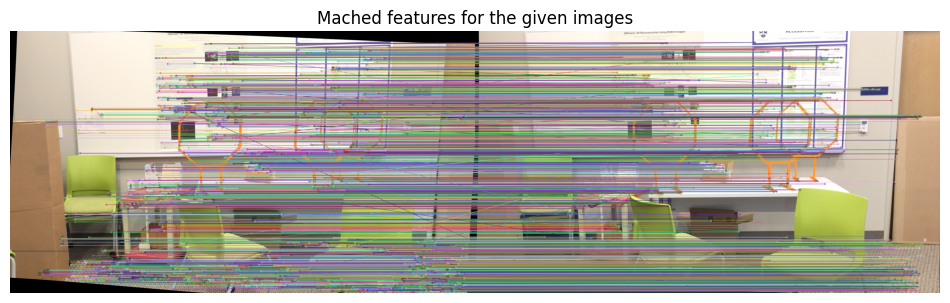

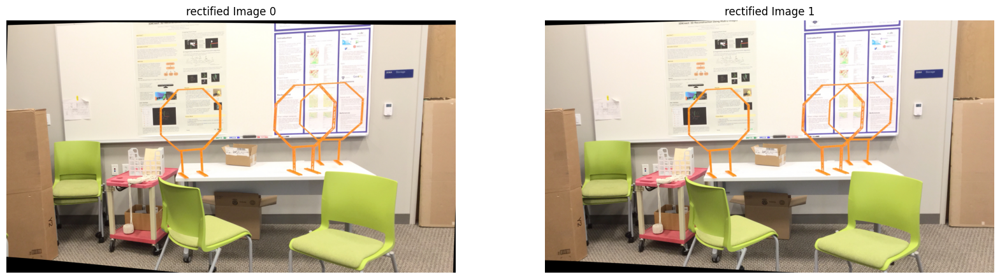

Homography Matrix for Image 1 (R1):
 [[ 5.63661165e+01 -2.87969480e-02  2.55727693e+01]
 [ 3.72208949e+01  9.74347477e-01  1.71897848e+01]
 [-1.19838572e+02  8.24329315e-02 -5.43452877e+01]]
Homography Matrix for Image 2 (R2):
 [[  55.86912747    0.54962041   25.52282412]
 [  36.88700035    1.36352746   17.15641044]
 [-118.76280088   -1.17027197  -54.23738815]]


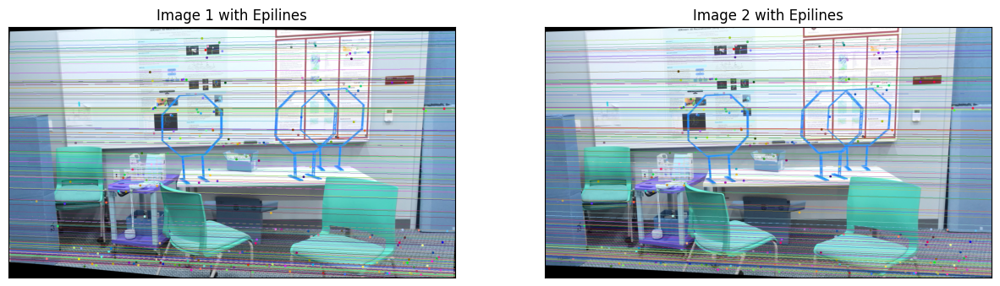

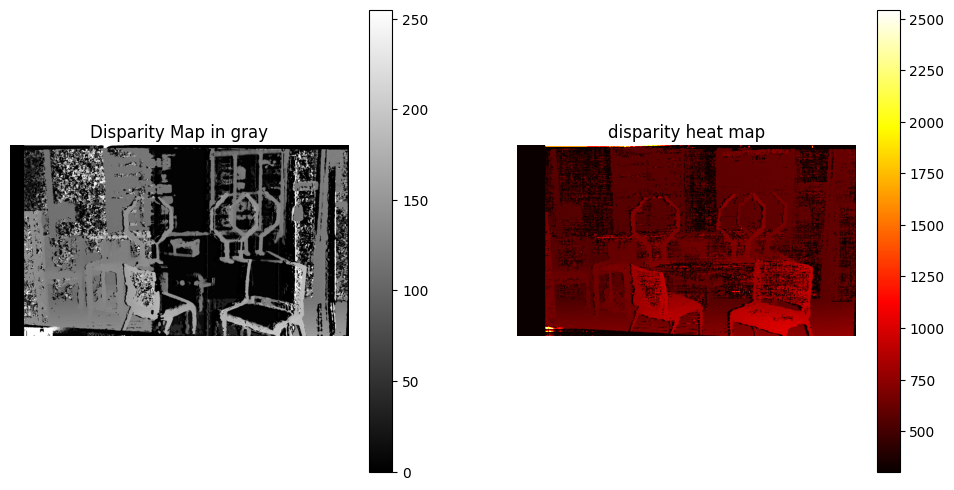

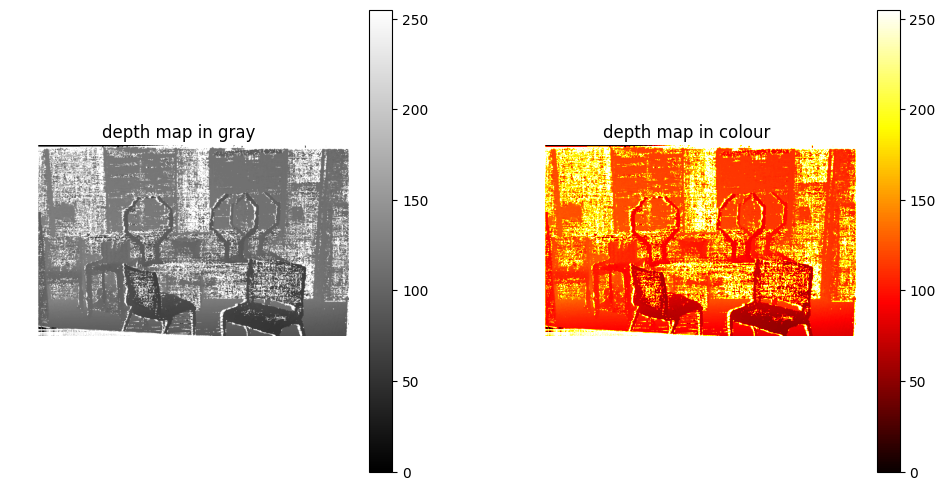

In [ ]:
calibration_data, rectified1,rectified2 = read('storageroom')

2.Classroom

{'cam0': array([[1.74624e+03, 0.00000e+00, 1.48800e+01],
       [0.00000e+00, 1.74624e+03, 5.34110e+02],
       [0.00000e+00, 0.00000e+00, 1.00000e+00]]), 'cam1': array([[1.74624e+03, 0.00000e+00, 1.48800e+01],
       [0.00000e+00, 1.74624e+03, 5.34110e+02],
       [0.00000e+00, 0.00000e+00, 1.00000e+00]]), 'doffs': 0, 'baseline': 678.37, 'width': 1920, 'height': 1080, 'ndisp': 310, 'vmin': 60, 'vmax': 280}
Fundamental Matrix (F): 
 [[-5.99928390e-22  2.74047288e-17 -1.47938701e-14]
 [-2.72511472e-17  2.51459985e-18  3.33333333e-01]
 [ 1.45379129e-14 -3.33333333e-01  1.00000000e+00]]
Essential Matrix (E): 
 [[ 4.16886767e-06  3.42331342e-03 -8.83666269e-03]
 [-2.93111122e-03 -1.52733602e-03 -7.07043931e-01]
 [ 8.37421103e-03  7.07047180e-01 -1.51907226e-03]]
Rotation Matrix (R): 
 [[ 9.99999531e-01  6.45144843e-04  7.21697652e-04]
 [-6.43586448e-04  9.99997465e-01 -2.15749781e-03]
 [-7.23087721e-04  2.15703232e-03  9.99997412e-01]]
Translation Vector (t): 
 [[-0.99991019]
 [ 0.01248646

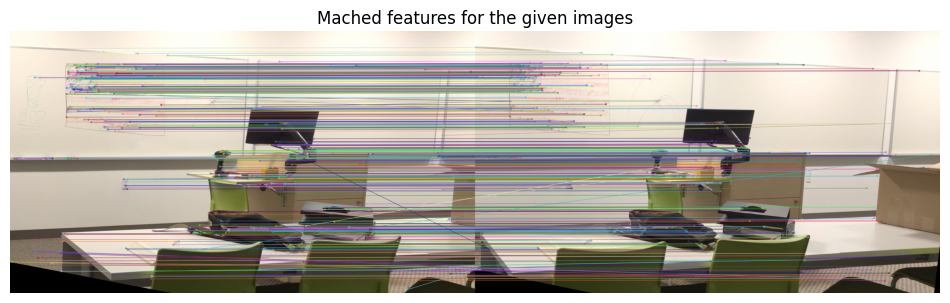

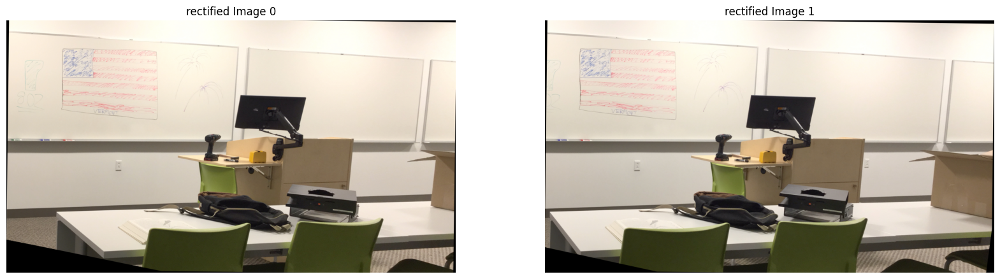

Homography Matrix for Image 1 (R1):
 [[ 0.93843085 -0.02751555 -0.00894291]
 [-2.19532013  0.4376884  -0.19069478]
 [ 7.21619933  1.83821198  1.62372215]]
Homography Matrix for Image 2 (R2):
 [[ 9.27670922e-01  3.99272379e-03  6.02215764e-04]
 [-2.58049995e+00  1.59143322e+00  1.58912993e-01]
 [ 8.47762771e+00 -1.93391164e+00  4.80715082e-01]]


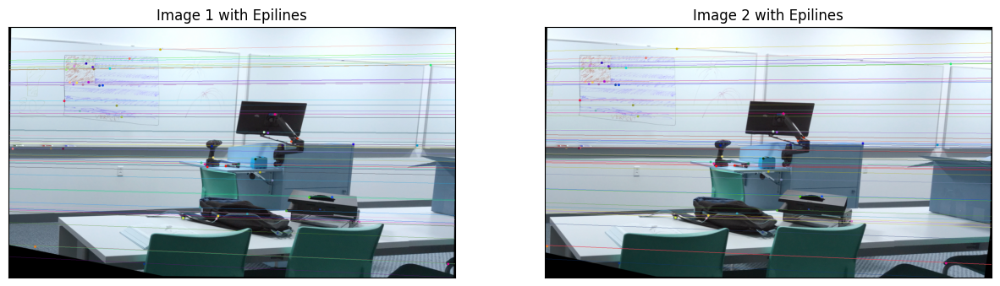

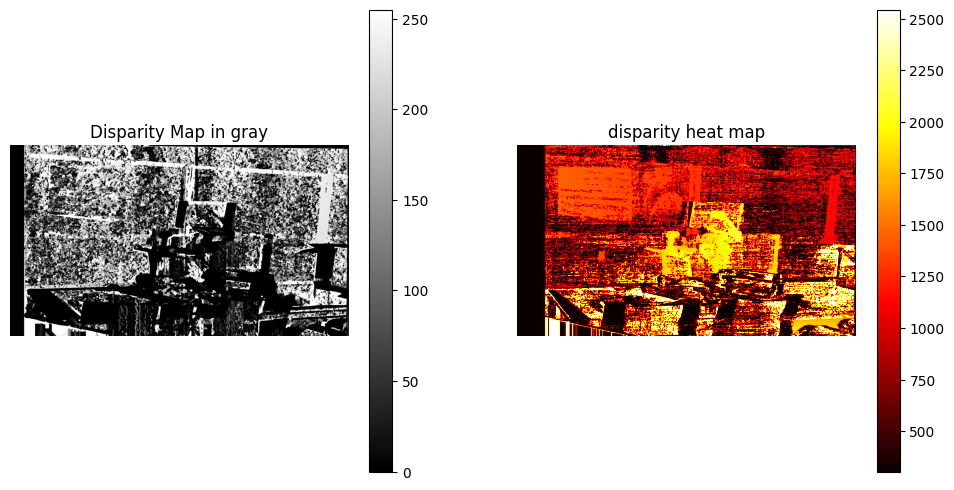

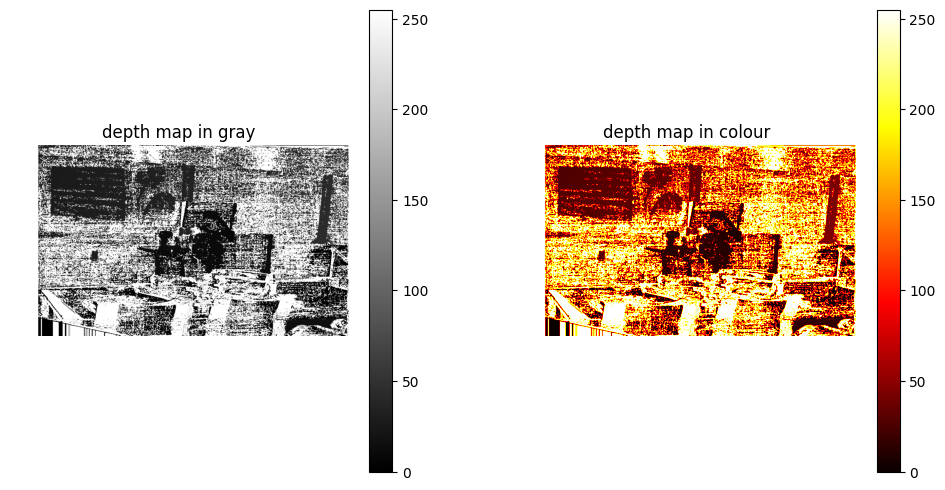

In [ ]:
calibration_data, rectified1,rectified2 = read('classroom')

3.Traproom

{'cam0': array([[1.76902e+03, 0.00000e+00, 1.27189e+03],
       [0.00000e+00, 1.76902e+03, 5.27170e+02],
       [0.00000e+00, 0.00000e+00, 1.00000e+00]]), 'cam1': array([[1.76902e+03, 0.00000e+00, 1.27189e+03],
       [0.00000e+00, 1.76902e+03, 5.27170e+02],
       [0.00000e+00, 0.00000e+00, 1.00000e+00]]), 'doffs': 0, 'baseline': 295.44, 'width': 1920, 'height': 1080, 'ndisp': 140, 'vmin': 25, 'vmax': 118}
Fundamental Matrix (F): 
 [[ 3.97533562e-07 -2.46910343e-04  1.45203693e-01]
 [ 2.37884249e-04 -6.43820202e-06  3.12375839e-01]
 [-1.40088221e-01 -3.11835973e-01  1.00000000e+00]]
Essential Matrix (E): 
 [[-1.10889911e-04  1.56293093e-02 -3.69340633e-02]
 [-1.70885159e-02 -1.07406073e-03 -7.05935118e-01]
 [ 3.52262325e-02  7.06053761e-01 -1.10691311e-03]]
Rotation Matrix (R): 
 [[ 0.99999517  0.0023836  -0.0019937 ]
 [-0.00238652  0.99999608 -0.0014637 ]
 [ 0.0019902   0.00146845  0.99999694]]
Translation Vector (t): 
 [[-0.99839029]
 [ 0.05220035]
 [ 0.02217992]]


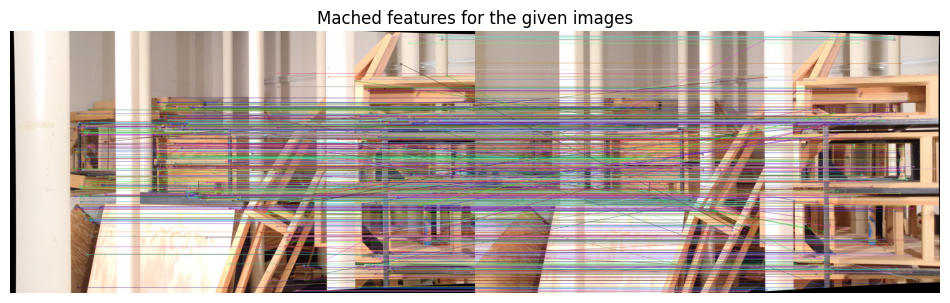

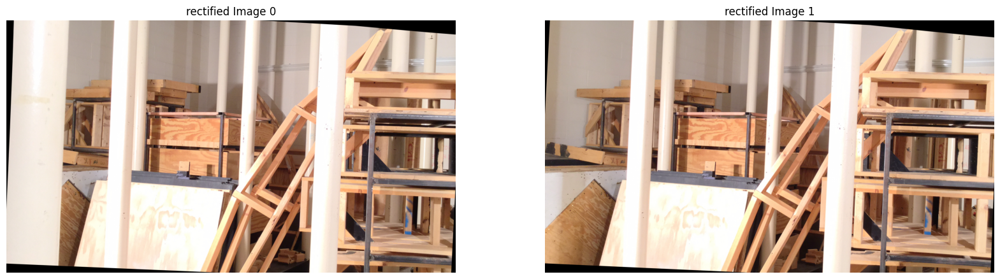

Homography Matrix for Image 1 (R1):
 [[-29.69532849  -0.26641593 -22.14852376]
 [-12.67205797   0.90899603  -9.13798951]
 [ 42.69074854   0.30120864  31.78326367]]
Homography Matrix for Image 2 (R2):
 [[-27.1607475    1.66560702 -19.75049708]
 [-11.61911628   1.71062851  -8.14207068]
 [ 39.1653979   -2.38922831  28.44689898]]


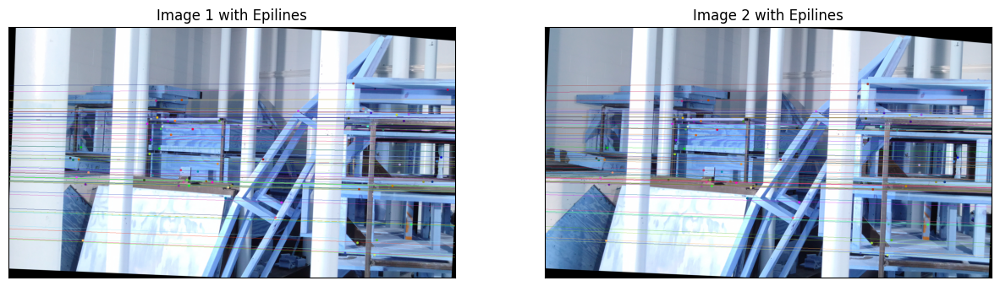

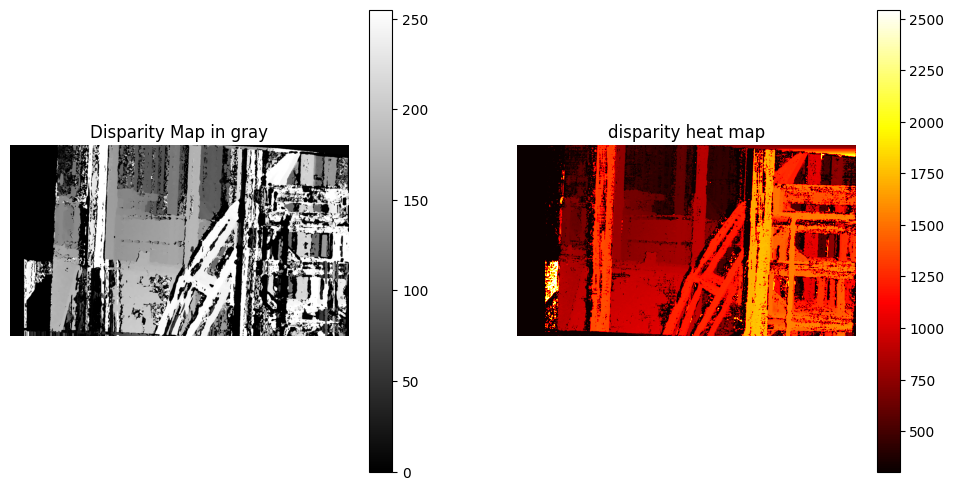

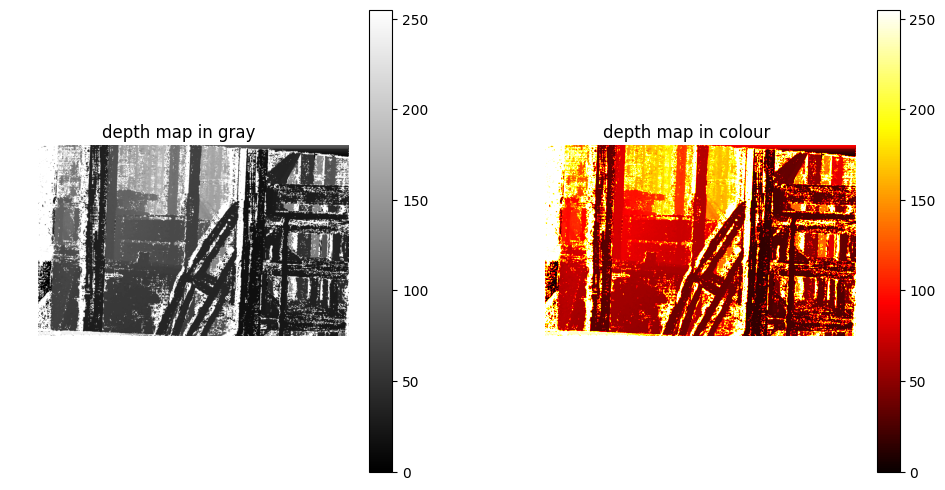

In [ ]:
calibration_data, rectified1,rectified2 = read('traproom')